In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#plt.style.use("thesis")
from os.path import join
import seaborn as sns
from sys import path
path.insert(0,'../src/')
from glob import glob
from chemulator import Chemulator
rollig_folder="../../Benchmarking/grid_inputs/"
import matplotlib.gridspec as gridspec
from time import perf_counter
import tensorflow as tf
tf.compat.v1.disable_eager_execution()
import h5py
#from snapshot_functions import get_elemental_abundances

In [2]:
autoencoder_dir="../models/autoencoder-2021-release/"
emulator=Chemulator(autoencoder_dir=autoencoder_dir)
emulator.load_model("../models/emulator-2021-release/")

In [3]:
data=pd.read_hdf("example_models.hdf",key="df").reset_index(drop=True)
data

,model,Time,gas_density,gas_temp,dust_temp,av,radfield,zeta,H,H+,...,MG+,CO+,CO,HCO+,O2,O2+,E-,coldens,h2col,ccol
0,6939,1000.0,2548.6,71.53,10.0,2.455700e-21,0.870462,2.253720,0.082356,1.691810e-08,...,0.000044,3.584520e-13,1.805500e-07,1.256760e-11,1.660070e-10,1.430850e-14,0.000274,3.904811e+00,5.069267e-08,1.109323e-07
1,6939,2000.0,2548.6,143.13,11.56,2.455700e-21,0.870462,2.253720,0.600815,2.050690e-07,...,0.000044,4.747840e-13,3.937840e-08,2.172240e-12,1.437690e-10,2.427510e-14,0.000315,3.904811e+00,5.069267e-08,1.109323e-07
2,6939,3000.0,2548.6,77.07,11.56,2.455700e-21,0.870462,2.253720,0.821727,2.591190e-07,...,0.000044,1.003860e-12,5.880830e-08,5.979380e-12,2.442260e-10,1.866310e-13,0.000322,3.904811e+00,5.069267e-08,1.109323e-07
3,6939,4000.0,2548.6,52.04,11.56,2.455700e-21,0.870462,2.253720,0.916669,5.381340e-07,...,0.000044,4.781420e-13,2.503280e-08,4.993680e-13,1.365850e-10,5.641730e-14,0.000317,3.904811e+00,5.069267e-08,1.109323e-07
4,6939,5000.0,2548.6,41.72,11.56,2.455700e-21,0.870462,2.253720,0.957926,7.702370e-07,...,0.000044,4.422410e-13,1.968780e-08,1.554400e-13,1.326230e-10,1.686190e-14,0.000313,3.904811e+00,5.069267e-08,1.109323e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9997,4951,996000.0,989240.0,100.00,15.02,1.818800e-04,3.222924,1.917344,0.044288,1.090620e-09,...,0.000008,3.464270e-15,3.740030e-05,1.879980e-12,1.153870e-10,1.765000e-15,0.000018,2.892011e+17,8.560156e+14,1.856038e+04
9998,4951,997000.0,989240.0,100.00,15.02,1.818800e-04,3.222924,1.917344,0.044271,1.084560e-09,...,0.000008,3.461970e-15,3.740030e-05,1.884360e-12,1.151710e-10,1.763940e-15,0.000018,2.892011e+17,8.560156e+14,1.856038e+04
9999,4951,998000.0,989240.0,99.95,15.02,1.818800e-04,3.222924,1.917344,0.044270,1.084390e-09,...,0.000008,3.461900e-15,3.740030e-05,1.884470e-12,1.151650e-10,1.763910e-15,0.000018,2.892011e+17,8.560156e+14,1.856038e+04
10000,4951,999000.0,989240.0,99.82,15.02,1.818800e-04,3.222924,1.917344,0.044274,1.085810e-09,...,0.000008,3.462430e-15,3.740030e-05,1.883440e-12,1.152150e-10,1.764160e-15,0.000018,2.892011e+17,8.560156e+14,1.856038e+04


In [4]:
data.values[:,0]

array(['6939', '6939', '6939', ..., '4951', '4951', '4951'], dtype=object)

In [5]:
print(max(np.log10(data["gas_temp"])))

3.924499996331074


#### We can take one random model between the 10 we have

In [6]:
#first we set the initial and final time and the index for the element in the initial time
t0=1000
tf=1e6
#Now the indexes where the models star at t0
index=data[(data["Time"]==t0)].index
steps=int((tf-t0)/1000.0)-1

In [7]:
emulator.physics_labels

['gas_temp',
 'gas_density',
 'radfield',
 'zeta',
 'coldens',
 'h2col',
 'ccol',
 'metallicity']

['gas_temp',
 'gas_density',
 'radfield',
 'zeta',
 'coldens',
 'h2col',
 'ccol',
 'metallicity']

In [8]:
data.rename(columns={'radfield':  'local_radfield'})

,model,Time,gas_density,gas_temp,dust_temp,av,local_radfield,zeta,H,H+,...,MG+,CO+,CO,HCO+,O2,O2+,E-,coldens,h2col,ccol
0,6939,1000.0,2548.6,71.53,10.0,2.455700e-21,0.870462,2.253720,0.082356,1.691810e-08,...,0.000044,3.584520e-13,1.805500e-07,1.256760e-11,1.660070e-10,1.430850e-14,0.000274,3.904811e+00,5.069267e-08,1.109323e-07
1,6939,2000.0,2548.6,143.13,11.56,2.455700e-21,0.870462,2.253720,0.600815,2.050690e-07,...,0.000044,4.747840e-13,3.937840e-08,2.172240e-12,1.437690e-10,2.427510e-14,0.000315,3.904811e+00,5.069267e-08,1.109323e-07
2,6939,3000.0,2548.6,77.07,11.56,2.455700e-21,0.870462,2.253720,0.821727,2.591190e-07,...,0.000044,1.003860e-12,5.880830e-08,5.979380e-12,2.442260e-10,1.866310e-13,0.000322,3.904811e+00,5.069267e-08,1.109323e-07
3,6939,4000.0,2548.6,52.04,11.56,2.455700e-21,0.870462,2.253720,0.916669,5.381340e-07,...,0.000044,4.781420e-13,2.503280e-08,4.993680e-13,1.365850e-10,5.641730e-14,0.000317,3.904811e+00,5.069267e-08,1.109323e-07
4,6939,5000.0,2548.6,41.72,11.56,2.455700e-21,0.870462,2.253720,0.957926,7.702370e-07,...,0.000044,4.422410e-13,1.968780e-08,1.554400e-13,1.326230e-10,1.686190e-14,0.000313,3.904811e+00,5.069267e-08,1.109323e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9997,4951,996000.0,989240.0,100.00,15.02,1.818800e-04,3.222924,1.917344,0.044288,1.090620e-09,...,0.000008,3.464270e-15,3.740030e-05,1.879980e-12,1.153870e-10,1.765000e-15,0.000018,2.892011e+17,8.560156e+14,1.856038e+04
9998,4951,997000.0,989240.0,100.00,15.02,1.818800e-04,3.222924,1.917344,0.044271,1.084560e-09,...,0.000008,3.461970e-15,3.740030e-05,1.884360e-12,1.151710e-10,1.763940e-15,0.000018,2.892011e+17,8.560156e+14,1.856038e+04
9999,4951,998000.0,989240.0,99.95,15.02,1.818800e-04,3.222924,1.917344,0.044270,1.084390e-09,...,0.000008,3.461900e-15,3.740030e-05,1.884470e-12,1.151650e-10,1.763910e-15,0.000018,2.892011e+17,8.560156e+14,1.856038e+04
10000,4951,999000.0,989240.0,99.82,15.02,1.818800e-04,3.222924,1.917344,0.044274,1.085810e-09,...,0.000008,3.462430e-15,3.740030e-05,1.883440e-12,1.152150e-10,1.764160e-15,0.000018,2.892011e+17,8.560156e+14,1.856038e+04


In [9]:
models=[]
i=data[(data["coldens"]*6.289E-22>0.1) & (data["Time"]==t0)].index
i=np.random.choice(i,replace=False)
models.append(i)
i=data[(data["coldens"]*6.289E-22>5) & (data["gas_temp"]<100) & (data["Time"]==t0)].index
i=np.random.choice(i)
models.append(i)
i=np.random.choice(data[(data["gas_temp"]>2000) & (data["Time"]==t0)].index)
models.append(i)
i=np.random.choice(data[(data["zeta"]>1000) & (data["Time"]==t0)].index)
models.append(i)
labels=["Av=0","High Av","High T","High $\zeta$"]

In [10]:
models

[5002, 2001, 4002, 8002]

In [11]:
init_cond=[]
for i in models:
    init_cond.append(emulator.prepare_inputs(
        data.loc[i:i].reset_index(drop=True),learn_scaling=False)
    )

C:\Users\Kingsman\.conda\envs\tf_cpu\lib\site-packages\keras\engine\training_v1.py:2067: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


In [12]:
init_cond[0]

,gas_temp,gas_density,radfield,zeta,coldens,h2col,ccol,metallicity,Chem_1,Chem_2,Chem_3,Chem_4,Chem_5,Chem_6,Chem_7,Chem_8
0,0.846891,0.654314,0.818907,0.246925,0.879638,0.465691,0.842779,0.69317,0.023746,0.342222,0.243734,0.051764,0.555586,0.037899,0.778844,0.520721


In [13]:
predictions=[]
steps=int((1e6-t0)/1000.0)-1
for cond in init_cond:
    pred=pd.DataFrame() #The empty dataFrame to fill it up with the prediction o each model
    for step in range(steps):
        output = emulator.predict_multiple_timesteps(cond,1)
        pred=pred.append(output,sort=False) #esto evalua el modelo
        cond["gas_temp"]=output["gas_temp"]#estas dos, actualizan las condiciones por las actuales
        cond[emulator.chem_labels]=output[emulator.chem_labels]
    predictions.append(pred)

C:\Users\Kingsman\.conda\envs\tf_cpu\lib\site-packages\keras\engine\training_v1.py:2067: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:108: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,"gas_temp"]=output[:,0]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAP

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:108: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\4224150144.py:7: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

##### Now we have the 4 models for the step size=1000

In [14]:
plot_specs=["gas_temp","dust_temp","H","H+","H2","C","C+","CO","O","O+","H2O"]
predicted_vals=[]
for i in range(4):
    predicted_vals.append(emulator.recover_real_values(predictions[i])[plot_specs])

C:\Users\Kingsman\.conda\envs\tf_cpu\lib\site-packages\keras\engine\training_v1.py:2067: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates=self.state_updates,


In [15]:
predicted_vals[0]

,gas_temp,dust_temp,H,H+,H2,C,C+,CO,O,O+,H2O
0,2172.577760,36.299718,1.000000,9.137409e-06,0.000117,2.101853e-08,3.146540e-05,1.329197e-08,0.000045,4.204298e-10,2.187849e-12
1,1232.155017,35.527056,1.000000,1.719590e-05,0.000349,6.962586e-08,5.009725e-05,1.131145e-07,0.000073,1.331578e-09,5.826229e-11
2,782.568385,33.576209,0.996751,1.609856e-05,0.000741,1.611505e-07,6.220580e-05,3.169494e-07,0.000101,1.861541e-09,4.062972e-10
3,562.826000,31.827019,0.842755,6.999162e-06,0.001368,3.672319e-07,4.303960e-05,7.513497e-07,0.000103,6.913862e-10,1.483568e-09
4,464.055240,31.224826,0.722546,1.868430e-06,0.002770,1.394553e-06,1.727413e-05,1.638948e-06,0.000096,1.248926e-10,4.672866e-09
...,...,...,...,...,...,...,...,...,...,...,...
993,11.484264,31.979877,0.000010,3.825526e-11,0.403494,3.736844e-05,5.084958e-10,6.696202e-05,0.000171,1.028599e-16,9.824394e-07
994,11.484264,31.979877,0.000010,3.825526e-11,0.403494,3.736844e-05,5.084958e-10,6.696202e-05,0.000171,1.028599e-16,9.824394e-07
995,11.484264,31.979877,0.000010,3.825526e-11,0.403494,3.736844e-05,5.084958e-10,6.696202e-05,0.000171,1.028599e-16,9.824394e-07
996,11.484264,31.979877,0.000010,3.825526e-11,0.403494,3.736844e-05,5.084958e-10,6.696202e-05,0.000171,1.028599e-16,9.824394e-07


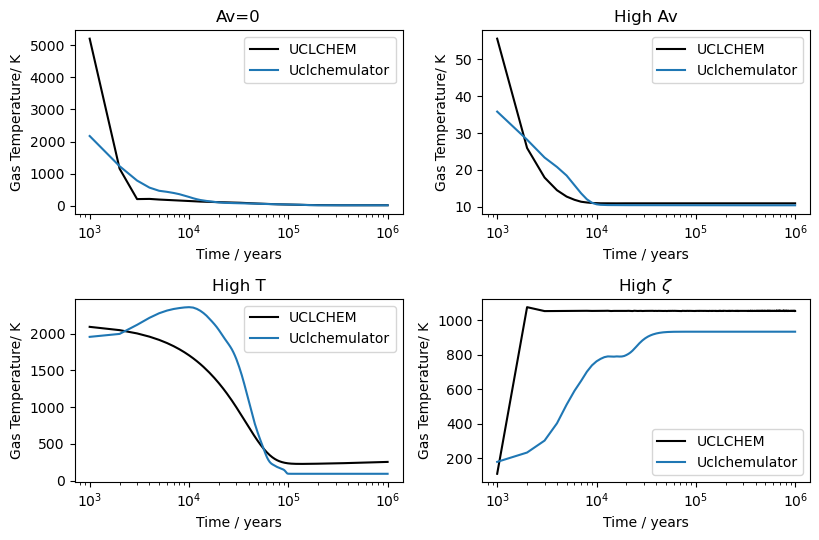

In [16]:
fig,axes=plt.subplots(2,2,figsize=(8.3,5.5),tight_layout=True)
axes=axes.flatten()

for i,ax in enumerate(axes):
    j=models[i]
    time=data.loc[j:j+steps-1,"Time"].values
    real_temp=data.loc[j:j+steps-1,"gas_temp"].values
    ax.plot(time,real_temp,label="UCLCHEM",color="black")
    ax.plot(time,predicted_vals[i]["gas_temp"],label="Uclchemulator")
    ax.set(xscale="log")
    ax.legend()
    ax.set(ylabel="Gas Temperature/ K",xlabel="Time / years")
    ax.set(title=labels[i])
#fig.savefig("dataset_time_testing.png",dpi=300)

In [17]:
models

[5002, 2001, 4002, 8002]

##### Let's take one by one of the models and take the three different timesteps

In [18]:
j=models[0]
data_av0=data.loc[j:j+steps-1]

In [19]:
data_av0 #actual data
data_av0['dust_temp']=pd.to_numeric(data_av0['dust_temp'])

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\2905009599.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_av0['dust_temp']=pd.to_numeric(data_av0['dust_temp'])


In [20]:
pred_av0 = predicted_vals[0] #predicciones

In [21]:
def get_plot_df(real,pred):
    df=pd.DataFrame({"Real":real,"Predicted":pred})
    df=df.groupby("Real")["Predicted"].agg([lambda x: np.percentile(x,10),
            lambda x: np.percentile(x,50),
            lambda x: np.percentile(x,90)]).reset_index()
    df.columns=["Real","lower","median","upper"]
    return df

In [22]:
# real_vals.shape
real=data_av0[plot_specs]
#predicted_vals.shape
predicted=pred_av0

predicted=predicted.to_numpy()
real=real.to_numpy()

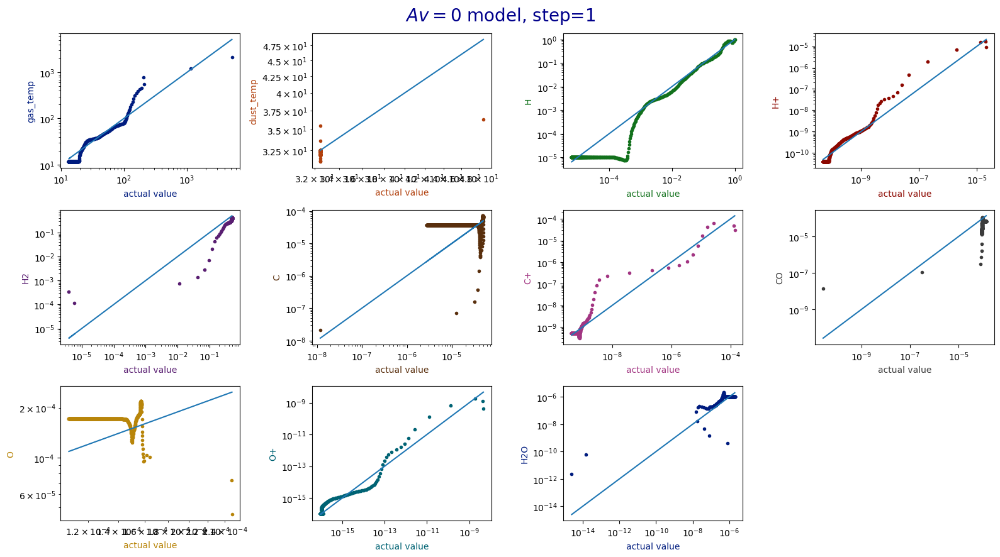

In [23]:
plot_specs=["gas_temp","dust_temp","H","H+","H2","C","C+","CO","O","O+","H2O"]
#fig,ax=plt.subplots(figsize=(25,12))
colors=sns.color_palette("dark",n_colors=11)
fig,axes=plt.subplots(3,4,tight_layout=True,figsize=(16,9))
axes=axes.flatten()

j=0
for i,ax in enumerate(axes[:-1]):
    ax.plot(data_av0[plot_specs[j]],pred_av0[plot_specs[j]],'.', color=colors[i])
    ax.plot(data_av0[plot_specs[j]],data_av0[plot_specs[j]])

    j=j+1
    ax.yaxis.label.set_color(colors[i])
    ax.xaxis.label.set_color(colors[i])
    ax.set(xscale="log",yscale="log",xlabel="actual value",ylabel=plot_specs[i])
fig.suptitle('$Av=0$ model, step=1', fontsize=20, color='darkblue')
#ax.legend()

axes[-1].remove()

#### Now lets try with the three time-steps fpr the four models

In [29]:
steps_1=int((1e6-t0)/1000.0)-1
steps_100=int((1e6-t0)/100.0)-1
steps_1000=int((1e6-t0)/1.0)-1

cond=init_cond[0]
predictions_av0=[]
inicio=time.time()
for p in range(len(pasos)): #esto toma los tres diferentes pasos
    pred=pd.DataFrame() #The empty dataFrame to fill it up with the prediction o each model
    paso=10**p
    for step in range(pasos[p]):
        print(paso)
end=time.time()

In [30]:
predictions_av0=predictions

In [ ]:
steps=steps_100
for cond in init_cond:
    pred=pd.DataFrame() #The empty dataFrame to fill it up with the prediction o each model
    for step in range(steps):
        output = emulator.predict_multiple_timesteps(cond,100)
        pred=pred.append(output,sort=False) #esto evalua el modelo
        cond["gas_temp"]=output["gas_temp"]#estas dos, actualizan las condiciones por las actuales
        cond[emulator.chem_labels]=output[emulator.chem_labels]
    predictions.append(pred)

C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, 

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\Chemulator-main\examples\../src\chemulator.py:109: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  input_data.loc[:,self.chem_labels]=output[:,2:]
C:\Users\Kingsman\AppData\Local\Temp\ipykernel_3172\3367804518.py:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  pred=pred.append(output,sort=False) #esto evalua el modelo
C:\Users\Kingsman\Desktop\Tareas Lap\LEAPS-2023-main\C

Now we have to compute the time_step 1000

In [ ]:
plot_df=pd.DataFrame()
plot_specs=["H","H+","H2","C","C+","CO","CH3OH","O","CH+","H2O","CO2","E-"]
plots=[0,1]+[i+2 for i in range(len(emulator.autoencoder.species)) if emulator.autoencoder.species[i] in plot_specs]
labels=["$log(T_g / K )$","$log(T_d / K )$"]+[f"log X({emulator.autoencoder.species[i-2]})"  for i in plots[2:] ]

for nsteps in [1000,100,1]:

    predict=emulator.recover_real_values(predicts[nsteps])
    predict=np.log10(predict).round(1)
    for i,idx in enumerate(plots):
        df=get_plot_df(reals[nsteps][:,idx],predict.values[:,idx])
        df["Quantity"]=labels[i]
        df["Nsteps"]=nsteps
        plot_df=plot_df.append(df)

NameError: name 'predicts' is not defined

In [ ]:
real.shape

(998, 11)

In [ ]:
predicted.shape

(998, 11)

In [ ]:
k=498
np.percentile(p[k*2:(k+1)*2],50)

NameError: name 'p' is not defined

In [ ]:
medianas_real=[]
medianas_pred=[]
std_up=[]
std_low=[]

for spec in range(11):
    r=np.sort(real[:,spec])
    #p=predicted[:,spec]
    index=[]
    for i in r:
        index.append(np.where(real[:,spec]==i)[0][0])
    p=predicted[:,spec][index]
    #Ahora r esta ordenado en forma ascendente y p esta ordenado de la misma manera
    r_med=[]
    p_med=[]
    s_up=[]
    s_low=[]
    for k in range(498):
        r_med.append(np.percentile(r[k*2:(k+1)*2],50))
        #p_med.append(np.median(p[k*2:(k+1)*2]))
        uper=np.percentile(np.log10(p[k*2:(k+1)*2]),90)
        m=np.percentile(p[k*2:(k+1)*2],50)
        lower=np.percentile(np.log10(p[k*2:(k+1)*2]),10)
        #standar=np.sum(( np.log2(p[k*2:(k+1)*2])-np.log2(np.mean(r[k*2:(k+1)*2])) )**2)
        #s.append(np.sqrt(standar/2))
        #s.append([uper,lower])
        p_med.append(m)
        s_up.append(uper)
        s_low.append(lower)


    medianas_real.append(r_med)
    medianas_pred.append(p_med)
    std_up.append(s_up)
    std_low.append(s_low)


medianas_real=[]
medianas_pred=[]
std=[]
for spec in range(11):
    r=np.sort(real[:,spec])
    #p=predicted[:,spec]
    index=[]
    for i in r:
        index.append(np.where(real[:,spec]==i)[0][0])
    p=predicted[:,spec][index]
    #Ahora r esta ordenado en forma ascendente y p esta ordenado de la misma manera
    r_med=[]
    p_med=[]
    s=[]
    for k in range(498):
        r_med.append(np.median(r[k*2:(k+1)*2]))
        p_med.append(np.median(p[k*2:(k+1)*2]))
        
        standar=np.sum(( np.log10(p[k*2:(k+1)*2])-np.log10(np.mean(r[k*2:(k+1)*2])) )**2)
        s.append(np.sqrt(standar/2))
        
    medianas_real.append(r_med)
    medianas_pred.append(p_med)
    std.append(s)

In [ ]:
# medianas_real1=np.log10(np.array(medianas_real))
# medianas_pred1=np.log10(np.array(medianas_pred))
# #std1=np.log10(np.array(std))
# std1_low=np.array(std_low)
# std1_up=np.array(std_up)

In [ ]:
medianas_real1=np.log10(np.array(medianas_real))
medianas_pred1=np.log10(np.array(medianas_pred))
#std1=np.log10(np.array(std))
std1=np.array(std)

In [ ]:
colors=sns.color_palette("dark",n_colors=11)
fig,axes=plt.subplots(3,4,tight_layout=True,figsize=(16,9))
axes=axes.flatten()

j=0
for i,ax in enumerate(axes[:-1]):
    x=np.log10(data_av0[plot_specs[j]].values)
    y=np.log10(pred_av0[plot_specs[j]].values)
    ax.plot(x,y,'.', color=colors[i])

    j=j+1

    ax.plot(medianas_real1[i],medianas_pred1[i],'-', color='green')
    ax.fill_between(medianas_real1[i], medianas_pred1[i]-std1[i], medianas_pred1[i]+std1[i], alpha=0.3, color='green')
    ax.plot(medianas_real1[i],medianas_real1[i],'--',color='darkred')

    ax.yaxis.label.set_color(colors[i])
    ax.xaxis.label.set_color(colors[i])
    ax.set(xlabel="actual value",ylabel=plot_specs[i])
fig.suptitle('Benchmarking for the ten models for the step size = 1000', fontsize=20, color='darkblue')
#ax.legend()

axes[-1].remove()

In [ ]:
colors=sns.color_palette("dark",n_colors=11)
fig,axes=plt.subplots(3,4,tight_layout=True,figsize=(16,9))
axes=axes.flatten()


j=0
for i,ax in enumerate(axes[:-1]):
    #x=np.log10(real[plot_specs[j]].values)
    #y=np.log10(predicted[plot_specs[j]].values)
    #ax.plot(x,y,'.', color=colors[j])
    #ax.plot(real[plot_specs[j]],real[plot_specs[j]])

    ax.plot(medianas_real1[i],medianas_pred1[i],'-', color='green')
    #ax.fill_between(medianas_real1[i], medianas_pred1[i]-std1_low[i],
                    #medianas_pred1[i]+std1_up[i], alpha=0.3, color='green')
    ax.fill_between(medianas_real1[i], std1_low[i], std1_up[i], alpha=0.3, color='green')
    ax.plot(medianas_real1[i],medianas_real1[i],'--',color='darkred')

    ax.yaxis.label.set_color(colors[i])
    ax.xaxis.label.set_color(colors[i])
    ax.set(xlabel="actual value",ylabel=plot_specs[i])
    j=j+1
fig.suptitle('Benchmarking for the ten models for the step size = 1000', fontsize=20, color='darkblue')
#ax.legend()

axes[-1].remove()

In [ ]:
test_steps=[1,100,1000]

input_data=data_av0[data_av0["Time"]==1000].reset_index(drop=True)
#estas van a ser las condiciones iniciales del emulador

#output_data=pd.read_hdf("../data/Small-Network-Emulator-Output.hdf",key="df").reset_index(drop=True)
output_data=data_av0 #estos son los valores que quderemos emular

#output_data=output_data.loc[output_data["Time"].isin(np.asarray(test_steps)*1000.0)].reset_index(drop=True)
idx=(output_data["Time"]==998000.0)
full_runs=output_data.loc[idx,"outputFile"].unique()

input_data=input_data[input_data["outputFile"].isin(full_runs)].sort_values("outputFile").reset_index(drop=True)
output_data=output_data[output_data["outputFile"].isin(full_runs)].sort_values(["Time","outputFile"]).reset_index(drop=True)


output_data["dust_temp"]=output_data["dust_temp"].astype(float)

In [ ]:
input_data=data_av0[data_av0["Time"]==1000].reset_index(drop=True)
input_data

,model,Time,gas_density,gas_temp,dust_temp,av,radfield,zeta,H,H+,...,MG+,CO+,CO,HCO+,O2,O2+,E-,coldens,h2col,ccol
0,4611,1000.0,2414900.0,55.55,19.3,23.152,87.649612,0.033289,0.000031,1.471000e-13,...,0.00002,1.207150e-18,0.00005,3.604370e-13,1.934970e-12,1.033920e-17,0.00002,3.681290e+22,2.161860e+21,5.435751e+17


In [ ]:
test_steps=[1,100,1000]

input_data=input_data[input_data["Time"]==0.0].reset_index(drop=True)

output_data=pd.read_hdf("../data/Small-Network-Emulator-Output.hdf",key="df").reset_index(drop=True)
output_data=output_data.loc[output_data["Time"].isin(np.asarray(test_steps)*1000.0)].reset_index(drop=True)
idx=(output_data["Time"]==1e6)
full_runs=output_data.loc[idx,"outputFile"].unique()

input_data=input_data[input_data["outputFile"].isin(full_runs)].sort_values("outputFile").reset_index(drop=True)
output_data=output_data[output_data["outputFile"].isin(full_runs)].sort_values(["Time","outputFile"]).reset_index(drop=True)


output_data["dust_temp"]=output_data["dust_temp"].astype(float)

array([['4611', 1000.0, 2414900.0, ..., 3.681289736425336e+22,
        2.1618597778871089e+21, 5.435750683772052e+17],
       ['4611', 2000.0, 2414900.0, ..., 3.681289736425336e+22,
        2.1618597778871089e+21, 5.435750683772052e+17],
       ['4611', 3000.0, 2414900.0, ..., 3.681289736425336e+22,
        2.1618597778871089e+21, 5.435750683772052e+17],
       ...,
       ['4611', 996000.0, 2414900.0, ..., 3.681289736425336e+22,
        2.1618597778871089e+21, 5.435750683772052e+17],
       ['4611', 997000.0, 2414900.0, ..., 3.681289736425336e+22,
        2.1618597778871089e+21, 5.435750683772052e+17],
       ['4611', 998000.0, 2414900.0, ..., 3.681289736425336e+22,
        2.1618597778871089e+21, 5.435750683772052e+17]], dtype=object)

In [ ]:
test_steps=[1,100,1000]
data=data[(data["Time"]==1000) & (data['model'] is in models)].reset_index(drop=True)
#input_data=input_data[input_data["Time"]==0.0].reset_index(drop=True)



output_data=data.loc[data["Time"].isin(np.asarray(test_steps)*1000.0)].reset_index(drop=True)

SyntaxError: invalid syntax (1875267321.py, line 2)

In [ ]:
data['model'].isin(models)

0    False
1    False
2    False
3    False
4    False
5    False
6    False
7    False
8    False
9    False
Name: model, dtype: bool

In [ ]:
models

[3001, 2001, 5002, 8002]

In [ ]:
data.loc[idx,"gas_temp"]

Series([], Name: gas_temp, dtype: float64)

In [ ]:
#idx array has the elements where the list ends
idx=(data["Time"]==1e6)

#here we have the different values of outputfile corresponding to the idx indexes
#full_runs=output_data.loc[idx,"outputFile"].unique()
full_runs=

#this in order to get the corresponding actual values in the "data" file.
data=data[data["outputFile"].isin(full_runs)].sort_values("outputFile").reset_index(drop=True)
#once they have the corresponding values, they sort the "data" according to the "oututFile" order.

#here they are taking the values of "outputFile" in "output_data" if they are in full_runs
output_data=output_data[output_data["outputFile"].isin(full_runs)].sort_values(["Time","outputFile"]).reset_index(drop=True)
#Then they sort the out_put values first in Time ordere, and "outputFile" in second place.

output_data["dust_temp"]=output_data["dust_temp"].astype(float)

KeyError: 'outputFile'